# Delta Hes Model
Based on these equations: 

$$\frac{dH_i}{dt} = \beta_H m_{h,i}(t-T_p) - \gamma_H H_i(t)$$

$$\frac{dm_{H,i}}{dt} = \beta_m(w_H \frac{p_H^l}{p_H^l + H_i(t-T_m)^l} + w_D \frac{<D(t-T_m)>_i^n}{p_D^n + <D(t-T_m)>_i^n}) - \gamma_m m_{H,i}(t)$$

$$\frac{dD_i}{dt} = \beta_D m_{D,i}(t-T_p) - \gamma_D D_i(t)$$

$$\frac{dm_{D,i}}{dt} = \beta_m \frac{p_H^l}{p_H^l + H_i(t-T_m)^l} - \gamma_m m_{H,i}(t)$$

Using non-dimensionalisation:
- $H_i = \tilde H h_i$ --> $\tilde H = p_H$
- $D_i = \tilde D d_i$ --> $\tilde D = p_D$
- $ t = \tilde t \tau$ --> $\tilde t = \gamma_m^{-1}$

and the following parameters: 
- $\alpha_H = \frac{\beta_H}{\gamma_H}$ 
- $\alpha_D = \frac{\beta_D}{\gamma_D}$
- $\mu = \frac{\gamma_H}{\gamma_m}$ 
- $\nu = \frac{\gamma_D}{\gamma_m}$

This gave me the following non-dimensionalised equations: 

$$\frac{d h_i}{d \tau} = \mu (\alpha_H m_{h,i}(\tau - \tau_p) - h_i(\tau))$$
$$\frac{dm_{h,i}}{d \tau} = w_H \frac{1}{1 + h_i(\tau-\tau_m)^l} + w_D \frac{<d(\tau-\tau_m)>_i^n}{1 + <d(\tau-\tau_m)>_i^n} - m_{h,i}(\tau)$$
$$\frac{d d_i}{d \tau} = \nu (\alpha_D m_{d,i}(\tau - \tau_p) - d_i(\tau))$$
$$\frac{dm_{d,i}}{d\tau} = \frac{1}{1 + h_i(\tau-\tau_m)^l} - m_{h,i}(\tau)$$

Note $\tau_p = \frac{T_p}{\tilde t}$ and $\tau_m = \frac{T_m}{\tilde t}$

Now using a quasi-steady state approximation with $\mu$ and $\nu$ being large we assume fast dynamics of Hes and Delta and get 

$$
h_i \approx \alpha_H m_{h,i}(\tau - \tau_p)
$$

$$
d_i \approx \alpha_D m_{d,i}(\tau - \tau_p)
$$

Then we obtain the following system:

$$
\frac{d m_{h,i}}{d \tau} = \alpha_m \left(w_H \frac{1}{1 + (\alpha_H m_{h,i}(\tau - \tau_p - \tau_m))^l} + w_D \frac{\langle (\alpha_D m_{d}(\tau - \tau_p - \tau_m))^n \rangle_i}{1 + \langle (\alpha_D m_{d}(\tau - \tau_p - \tau_m))^n \rangle_i} \right) - m_{h,i}(\tau)
$$

$$
\frac{d m_{d,i}}{d \tau} = \alpha_m \frac{1}{1 + (\alpha_H m_{h,i}(\tau - \tau_p - \tau_m))^l} - m_{d,i}(\tau)
$$


In [3]:
# import necessary packages
import numpy as np
import matplotlib.pyplot as plt
from types import SimpleNamespace
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from tqdm import tqdm
#import visualisation as vis

In [23]:
def get_params(gamma_h, gamma_d, gamma_m, p_h, p_d, T_h, T_coupling, w_h, w_coupling, l, n, lattice, grad_hes = True, grad_coup = True, grad_hes_strength = 0, grad_coup_strength = 0):
    """Returns a SimpleNamespace containing model parameters calculated from physical parameters."""
    
    params = SimpleNamespace(
        gamma_h = gamma_h,
        gamma_d = gamma_d,
        gamma_m = gamma_m,
        p_h = p_h,
        p_d = p_d,
        T_h = T_h,
        T_coupling = T_coupling,
        w_h = w_h,
        w_coupling = w_coupling,
        l = l,
        n = n
    )
    
    if grad_hes:
        params.T_h = grad_hes_strength * np.arange(0, lattice.P) + params.T_h
    else:
        params.T_h = np.ones(lattice.P) * params.T_h
    
    if grad_coup:
        params.T_coupling = grad_coup_strength * np.arange(0, lattice.P) + params.T_coupling
    else:
        params.T_coupling = np.ones(lattice.P) * params.T_coupling

    return params


def get_lattice(P, Q):
    lattice = SimpleNamespace()
    # get sizes of the system 
    lattice.P = P            # length of PSM + tailbud
    lattice.Q = Q            # diameter (2D so width) of PSM and tailbud, if Q = 1 then we have 1D system

    # define the weights, connectivity matrix and coupling strength between the cells 
    if lattice.Q > 1:
        lattice.w = 4*np.ones([P, Q])    # weight if each cell has 4 neighbours
        lattice.w[0, :] = 3              # weights of the edges is 3
        lattice.w[-1, :] = 3
        lattice.w[:, 0] = 3
        lattice.w[:, -1] = 3
        lattice.w[0, 0] = 2              # weights of the corners is 2
        lattice.w[-1, 0] = 2 
        lattice.w[0, -1] = 2
        lattice.w[-1, -1] = 2     

    else:
        lattice.w = 2*np.ones(P)
        lattice.w[0] = 1        # weight of first and last cell is only 1
        lattice.w[-1] = 1        

    lattice.connectivity = connectivitymatrix(lattice.P, lattice.Q)    # connectivity matrix 

    return lattice

def get_initial(lattice, params, initial_type = 'checkerboard'):
    U = np.random.uniform(0,1,[lattice.P, lattice.Q]) - 1/2      #a uniform random distribution
    epsilon = 1e-5
    sigma = 0.2
                                                        #multiplicative factor of Delta initial condition
    d0 = epsilon*(1 + sigma*U) 

    if initial_type == 'uniform':
        h0 = np.zeros([lattice.P, lattice.Q]) 

    elif initial_type == 'checkerboard':
        h0 = create_checkerboard(lattice.P, lattice.Q, val1=0, val2= 1/params.gamma_h) # checkerboard pattern of Hes initial condition
        
    m_h0 = np.zeros([lattice.P, lattice.Q])
    m_d0 = np.zeros([lattice.P, lattice.Q])

    return h0, m_h0, d0, m_d0


def connectivitymatrix(P, Q):
    '''Calculates the connectivity matrixs'''
    k = P*Q                 # number of cells 
    M = np.zeros([k,k])     # connectivity matrix

    # calculating the connectivity matrix

    for i in range(k):
        i_neighbour = findneigbours(i, P, Q)

        # check if the neighbours are within the range of the system
        for j in i_neighbour:
            if 0 <= j:
                M[i, j] = 1
    
    return M   

def findneigbours(index, P, Q):
    '''Finds neighbours of cell with index for system of P, Q cells'''
    
    # finding neighbours for line of cells
    if Q == 1:
        left = int(index - 1)
        right = int(index + 1)

        # check if the cell is on the edge of the system
        if index % P == 0:
            left = -1
        if index % P == P - 1:
            right = -1

        neighbours = [left, right]   
    # finding neighbours for 2D system of cells
    elif Q > 1: 

        left = index - 1
        right = index + 1
        up = index - P
        down = index + P

        # check if the cell is on the edge of the system
        if index % P == 0:
            left = -1
        if index % P == P - 1:
            right = -1
        if index < P:
            up = -1
        if index >= P*(Q-1):
            down = -1
        neighbours = [left, right, up, down]
                
    else: 
        print('Q should be at least 1')

    return neighbours

def hill_function_positive(x, coeff, threshold):
    """Non-dimensionalized Hill function with exponent l."""
    return x**coeff / (threshold**coeff + x**coeff)

def hill_function_negative(x, coeff, threshold):
    """Non-dimensionalized Hill function with exponent n."""
    return threshold**coeff / (threshold**coeff + x**coeff)

def get_delayed_value(values_array, current_index, delay_steps, lattice, params):
    """Retrieves the value from a past step in the simulation."""

    values_delayed = values_array.copy()

    for p in range(lattice.P):
        delayed_index = max(0, current_index - delay_steps[p])
        values_delayed[current_index, p, :] = values_array[delayed_index, p, :]


    return values_delayed

def d_neighbours(values, lattice):
    if lattice.Q == 1:
        axis = 0
    else:
        axis = 1
    #print(d.shape)
    d_neighbours = np.sum(lattice.connectivity * values.flatten() / lattice.w.flatten(), axis=axis)
    #print(d_neighbours.shape)
    d_neighbours = d_neighbours.reshape(lattice.P, lattice.Q)

    return d_neighbours

def Euler(x, dx_dt, dt):
    x_new = x + dx_dt*dt
    return x_new

def dh_dt(h, m_h, params):
    """ODE for dh/dtau with time delay."""
    return m_h - params.gamma_h*h

def dmh_dt(m_h, h_delay, couple_component, params, lattice):
    """ODE for dm_h/dtau with time delay."""
    return params.w_h * hill_function_negative(h_delay, int(params.l), params.p_h) + params.w_coupling * couple_component - params.gamma_m*m_h

def dd_dt(d, m_d, params):
    """ODE for dd/dtau with time delay."""
    return m_d - params.gamma_d*d

def dmd_dt(m_d, h_delay, params):
    """ODE for dm_d/dtau with time delay."""
    return hill_function_negative(h_delay, int(params.n), params.p_h) - params.gamma_m*m_d


def animate_2D(data, interval=5, plot_save=False, filename='Animation_grid.gif', title = ''):
    """
    Create a 2D animation of a grid from a 3D array.
    
    Parameters:
    - data: 3D numpy array of shape (grid_size, grid_size, num_tsteps)
    - interval: Time between frames in milliseconds
    
    Returns:
    - HTML object to display in Jupyter Notebook
    """

    # transpose axis 1 and 2 of data
    data = np.transpose(data, axes = (0, 2, 1))
    # data = np.transpose(data, axes = (1, 0, 2))

    num_tsteps = data.shape[0]

    # Set up the figure and two axes for vertically stacked images
    fig, ax = plt.subplots(1, 1, figsize=(data.shape[2]/3, data.shape[1]/3 + 2), constrained_layout=True)

    # Plot the first image
    im = ax.imshow(data[0,:,:], cmap='YlOrRd', aspect='equal', vmin = np.min(data), vmax = np.max(data))
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel('Posterior PSM --> Anterior PSM')
    ax.set_ylabel('Width of PSM')
    ax.set_title(title)
    
    # Add colorbar for the first image
    cbar1 = fig.colorbar(im, ax=ax, orientation='horizontal', fraction=0.1, pad=0.2)
    cbar1.set_label('Hes concentration')

    # Add a text annotation for timeframe
    timeframe_text = ax.text(0.05, 0.95, f'Time: 0', color='white', fontsize=12, transform=ax.transAxes, ha='left', va='top', bbox=dict(facecolor='black', alpha=0.5))

    # Update function for animation
    def update(frame):
        im.set_array(data[frame,:,:])
        timeframe_text.set_text(f'Time: {frame*interval}')  # Update timeframe text
        return [im]

    # Create the animation
    ani = FuncAnimation(
        fig, update, frames=num_tsteps, interval=interval, blit=True)
    if plot_save:
        ani.save(filename, writer='imagemagick', fps=10)
    
    # Convert animation to HTML for Jupyter Notebook
    return HTML(ani.to_jshtml())

def create_checkerboard(P, Q, val1=0, val2=5):
    """
    Create a P x Q checkerboard pattern with alternating values.
    
    Parameters:
    - P: Number of rows (height of the lattice)
    - Q: Number of columns (width of the lattice)
    - val1: Value for the first set of squares (default 0)
    - val2: Value for the alternating set of squares (default 5)
    
    Returns:
    - checkerboard: NumPy array of shape (P, Q)
    """
    checkerboard = np.zeros((P, Q))
    
    # Assign values based on checkerboard pattern
    for i in range(P):
        for j in range(Q):
            if (i + j) % 2 == 0:
                checkerboard[i, j] = val1
            else:
                checkerboard[i, j] = val2
    
    return checkerboard

def simulate(num_tsteps, dt, lattice, params, coupling_type, initial_type = 'checkerboard'):

    h_init, m_h_init, d_init, m_d_init = get_initial(lattice, params, initial_type)

    #intrinsic oscillator components
    h = np.zeros([num_tsteps, lattice.P, lattice.Q])
    m_h = np.zeros([num_tsteps, lattice.P, lattice.Q])
    h[0] = h_init
    m_h[0] = m_h_init

    #coupling components
    m_d = np.zeros([num_tsteps, lattice.P, lattice.Q])
    d = np.zeros([num_tsteps, lattice.P, lattice.Q])
    m_d[0] = m_d_init
    d[0] = d_init

    for i in tqdm(range(int(num_tsteps-1))):
        # internal oscillator delay if applicable
        params.T_h_steps = np.round(params.T_h / dt).astype(int)
        h_delay = get_delayed_value(h, i, params.T_h_steps, lattice, params)

        # coupling delay if applicable
        params.T_coup_steps = np.round(params.T_coupling / dt).astype(int)
        d_delay = get_delayed_value(d, i, params.T_coup_steps, lattice, params)

        if i == 0:
            print('T_h_steps:', params.T_h_steps)
            print('T_coup_steps:', params.T_coup_steps)

        # coupling dynamics 
        if coupling_type == 'Delta':
            d_tau_neighbours = d_neighbours(d_delay[i,:,:], lattice)
            d[i+1,:,:] = Euler(d[i,:,:], dd_dt(d[i,:,:], m_d[i,:,:], params), dt)
            m_d[i+1,:,:] = Euler(m_d[i,:,:], dmd_dt(m_d[i,:,:], h_delay[i,:,:], params), dt)
            couple_component = hill_function_positive(d_tau_neighbours, int(params.l), params.p_d)

        # calculate the values of the next time step
        h[i+1,:,:] = Euler(h[i,:,:], dh_dt(h[i,:,:], m_h[i,:,:], params), dt)
        m_h[i+1,:,:] = Euler(m_h[i,:,:], dmh_dt(m_h[i,:,:], h_delay[i,:,:], couple_component, params, lattice), dt)


    return h, m_h, d, m_d   



## Parameters 

In [42]:
#set the lattice of the cells 
P = 20
Q = 1

lattice = get_lattice(P, Q)

# # set initial parameters of the reactions 
gamma_h = 0.03
gamma_d = 0.03
gamma_m = 0.03
p_h = 100
p_d = 100
T_h = 20
T_coupling = 0
w_h = 1
w_coupling = 0.01
l = 5
n = 3

params = get_params(gamma_h, gamma_d, gamma_m, p_h, p_d, T_h, T_coupling, w_h, w_coupling, l, n, lattice, grad_hes = True, grad_coup = False, grad_hes_strength = 0.2, grad_coup_strength = 0)

print(params)



namespace(gamma_h=0.03, gamma_d=0.03, gamma_m=0.03, p_h=100, p_d=100, T_h=array([20. , 20.2, 20.4, 20.6, 20.8, 21. , 21.2, 21.4, 21.6, 21.8, 22. ,
       22.2, 22.4, 22.6, 22.8, 23. , 23.2, 23.4, 23.6, 23.8]), T_coupling=array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0.]), w_h=1, w_coupling=0.01, l=5, n=3)


## Simulation

In [43]:
num_tsteps = 10000
dt = 0.2
h, m_h, d, m_d = simulate(num_tsteps, dt, lattice, params, coupling_type= 'Delta', initial_type='checkerboard')

  1%|          | 107/9999 [00:00<00:18, 537.15it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 513.75it/s]


## 2D system variance for different values of coupling strength + Hill coefficient

In [13]:
# code for testing multiple coupling strengths and Hill coefficients
def test_Delta_coup(coefficient, coup_strength, lattice, num_tsteps, dt):
    print('Coefficient:', coefficient)
    print('Coupling strength:', coup_strength)
    params = get_params(gamma_h, gamma_d, gamma_m, p_h, p_d, T_h, T_coupling, w_h, coup_strength, l, coefficient, lattice, grad_hes = True, grad_coup = True, grad_hes_strength = 0.2, grad_coup_strength = 0)
    h, m_h, d, m_d = simulate(num_tsteps, dt, lattice, params, coupling_type= 'Delta', initial_type='checkerboard')
    return h, m_h, d, m_d

def test_results(results):
    std = np.std(results, axis=1)
    mean = np.mean(results, axis=1)
    
    return std, mean

num_tsteps = 10000
dt = 0.2

coefficients = [1, 2, 3, 4, 5]
coupling_strengths = [0, 0.05, 0.1, 0.2, 0.4]
results = np.zeros([5, 5, num_tsteps, lattice.P, lattice.Q])

for i in range(len(coefficients)):
    for j in range(len(coupling_strengths)):
        coeff = coefficients[i]
        coup_strength = coupling_strengths[j]
        h, m_h, d, m_d = test_Delta_coup(coeff, coup_strength, lattice, num_tsteps, dt)

        results[i, j,:,:,:] = h



Coefficient: 1
Coupling strength: 0
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 12/9999 [00:00<01:33, 106.85it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:35<00:00, 104.51it/s]


Coefficient: 1
Coupling strength: 0.05
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 8/9999 [00:00<02:17, 72.54it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:40<00:00, 99.57it/s] 


Coefficient: 1
Coupling strength: 0.1
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 11/9999 [00:00<01:31, 108.87it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:35<00:00, 104.74it/s]


Coefficient: 1
Coupling strength: 0.2
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 6/9999 [00:00<03:02, 54.74it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:39<00:00, 100.14it/s]


Coefficient: 1
Coupling strength: 0.4
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 9/9999 [00:00<01:58, 83.99it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:37<00:00, 102.68it/s]


Coefficient: 2
Coupling strength: 0
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 14/9999 [00:00<01:14, 133.50it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:21<00:00, 122.63it/s]


Coefficient: 2
Coupling strength: 0.05
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 13/9999 [00:00<01:20, 123.44it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:17<00:00, 128.29it/s]


Coefficient: 2
Coupling strength: 0.1
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 15/9999 [00:00<01:10, 141.45it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:23<00:00, 120.38it/s]


Coefficient: 2
Coupling strength: 0.2
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 10/9999 [00:00<01:40, 99.79it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:33<00:00, 106.42it/s]


Coefficient: 2
Coupling strength: 0.4
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 11/9999 [00:00<01:31, 109.76it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:37<00:00, 102.35it/s]


Coefficient: 3
Coupling strength: 0
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 10/9999 [00:00<02:01, 82.55it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:21<00:00, 122.94it/s]


Coefficient: 3
Coupling strength: 0.05
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 11/9999 [00:00<01:31, 109.35it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:14<00:00, 134.29it/s]


Coefficient: 3
Coupling strength: 0.1
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 7/9999 [00:00<02:24, 69.36it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:19<00:00, 125.92it/s]


Coefficient: 3
Coupling strength: 0.2
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 12/9999 [00:00<01:24, 118.86it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:34<00:00, 106.03it/s]


Coefficient: 3
Coupling strength: 0.4
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 6/9999 [00:00<02:47, 59.52it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:28<00:00, 112.84it/s]


Coefficient: 4
Coupling strength: 0
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 10/9999 [00:00<01:44, 95.95it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:15<00:00, 132.66it/s]


Coefficient: 4
Coupling strength: 0.05
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 11/9999 [00:00<01:31, 109.18it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:15<00:00, 132.30it/s]


Coefficient: 4
Coupling strength: 0.1
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 12/9999 [00:00<01:27, 113.58it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:23<00:00, 119.63it/s]


Coefficient: 4
Coupling strength: 0.2
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 9/9999 [00:00<01:59, 83.80it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:39<00:00, 100.96it/s]


Coefficient: 4
Coupling strength: 0.4
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 8/9999 [00:00<02:06, 78.81it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:26<00:00, 115.35it/s]


Coefficient: 5
Coupling strength: 0
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 8/9999 [00:00<02:12, 75.65it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:39<00:00, 100.25it/s]


Coefficient: 5
Coupling strength: 0.05
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 7/9999 [00:00<02:24, 69.18it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:39<00:00, 100.37it/s]


Coefficient: 5
Coupling strength: 0.1
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 8/9999 [00:00<02:17, 72.53it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:28<00:00, 112.46it/s]


Coefficient: 5
Coupling strength: 0.2
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 8/9999 [00:00<02:07, 78.62it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:42<00:00, 97.23it/s] 


Coefficient: 5
Coupling strength: 0.4
namespace(P=20, Q=6, w=array([[2., 3., 3., 3., 3., 2.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [3., 4., 4., 4., 4., 3.],
       [2., 3., 3., 3., 3., 2.]]), connectivity=array([[0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.]]))


  0%|          | 9/9999 [00:00<02:01, 82.12it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [01:39<00:00, 100.62it/s]


### Save to file

In [14]:
# save the results to a file\
import pickle

data = results

with open("results_delta_std_15_04.pkl", "wb") as file:
    pickle.dump(data, file)

### Plot for each P value

C:\Users\kbmcd\AppData\Local\Temp\ipykernel_20300\1729508833.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


<Figure size 640x480 with 0 Axes>

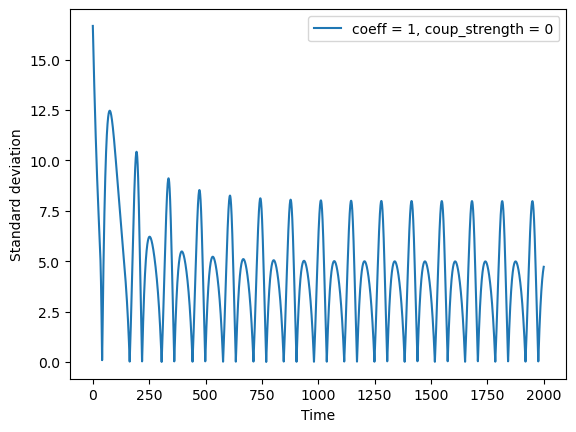

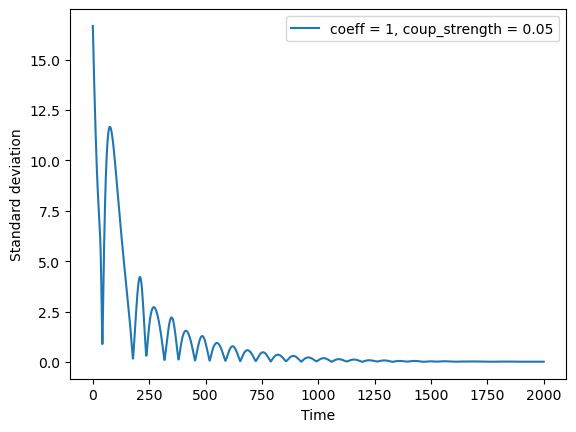

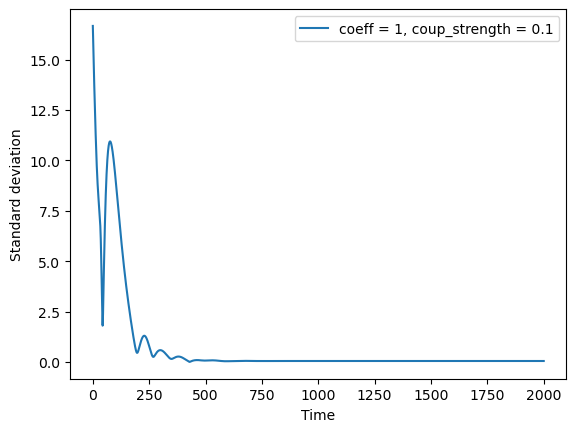

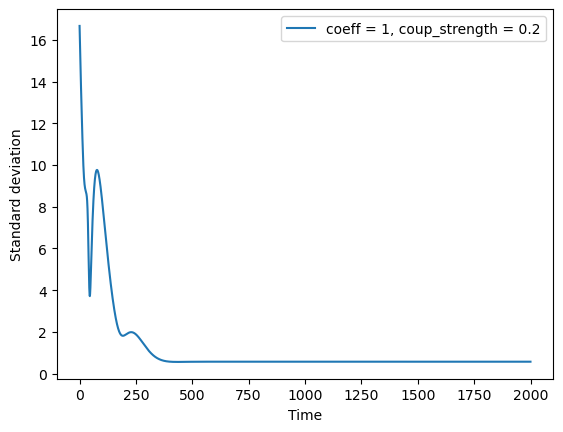

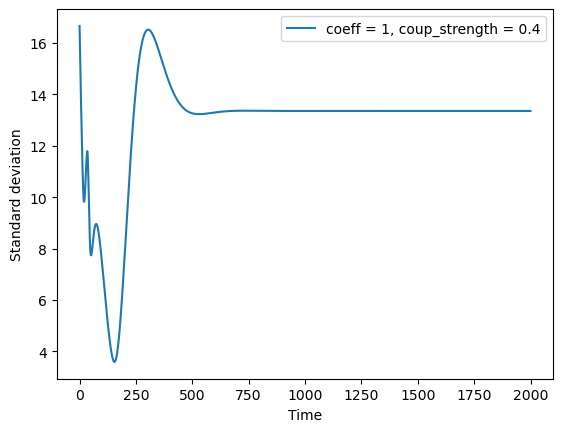

...

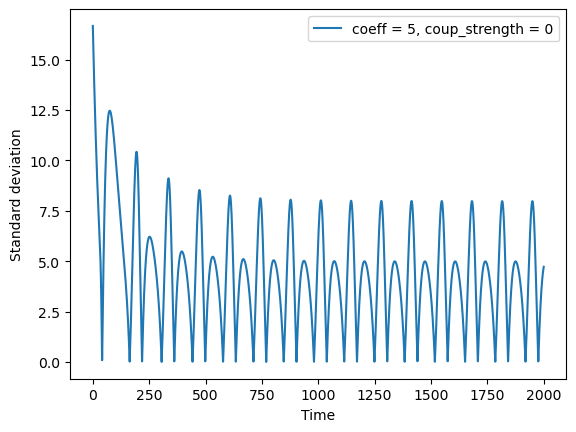

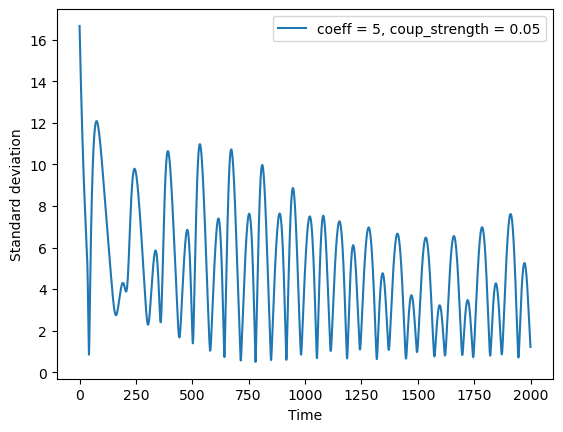

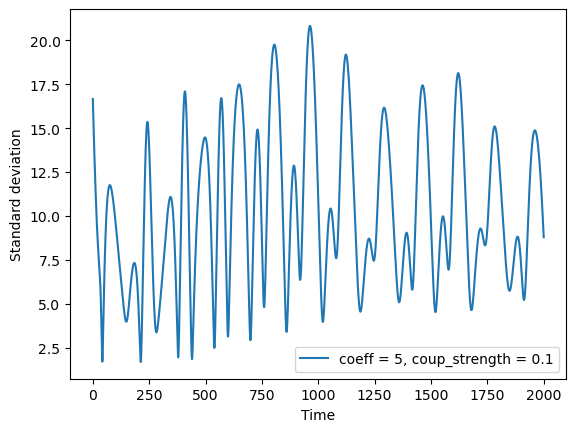

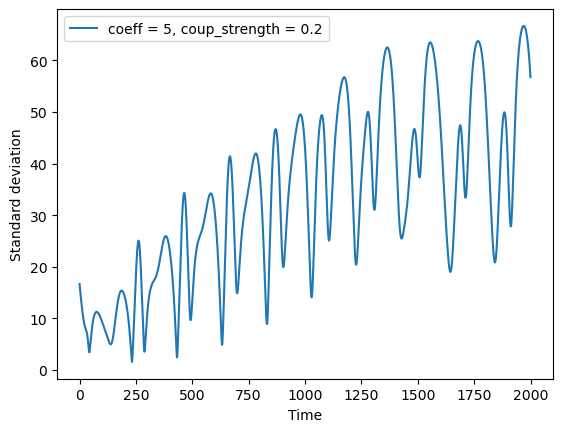

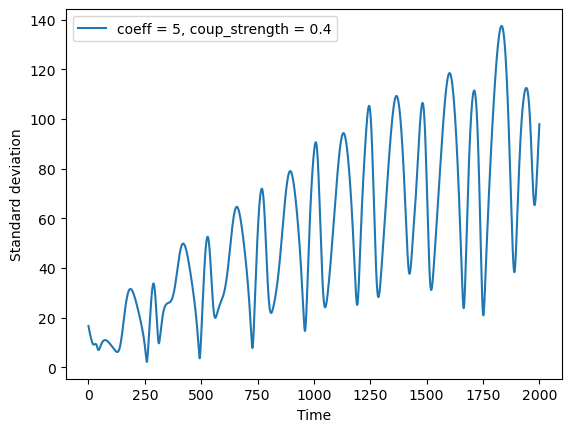

In [15]:
P_of_interest = 10

standard_deviation = np.zeros([len(coefficients), len(coupling_strengths), num_tsteps])
mean = np.zeros([len(coefficients), len(coupling_strengths), num_tsteps])

plt.figure()
for i in range(len(coefficients)):
    for j in range(len(coupling_strengths)):
        values = results[i, j, :, :, :]
        for k in range(num_tsteps):
            standard_deviation[i,j,k] = np.std(values[k, P_of_interest, :])
            mean[i,j] = np.mean(values[k, P_of_interest, :])
        plt.figure()
        plt.plot(np.arange(num_tsteps)*dt, standard_deviation[i,j], label = f'coeff = {coefficients[i]}, coup_strength = {coupling_strengths[j]}')
        plt.xlabel('Time')
        plt.ylabel('Standard deviation')
        plt.legend()


        

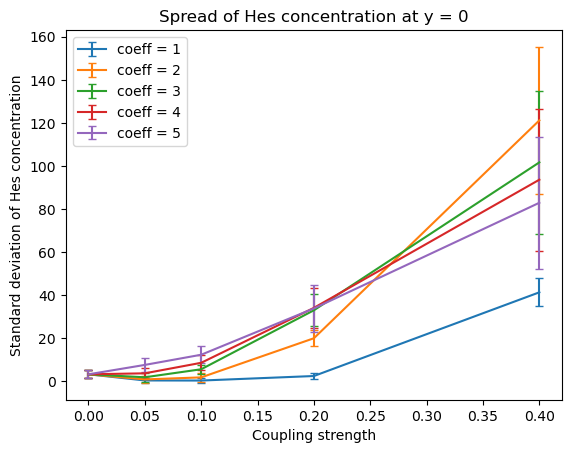

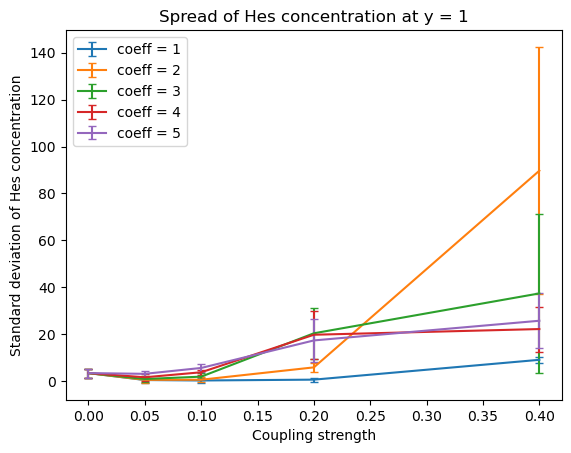

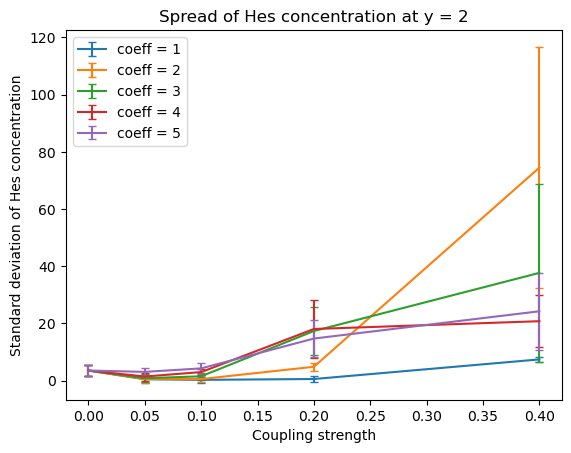

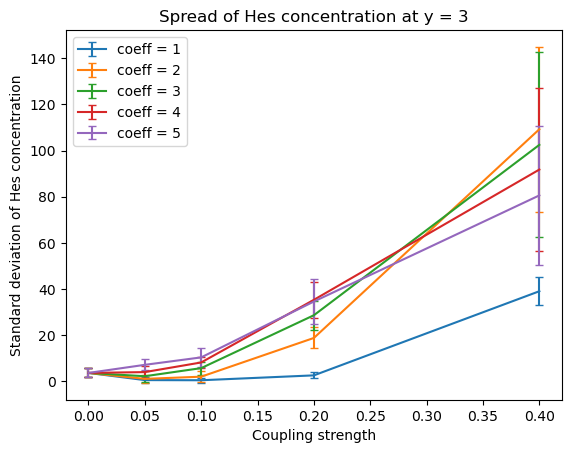

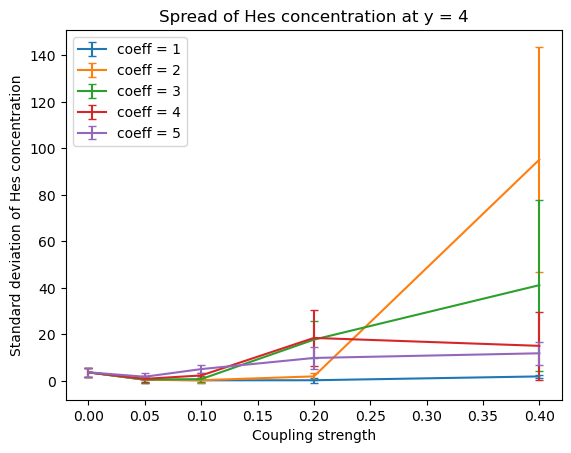

...

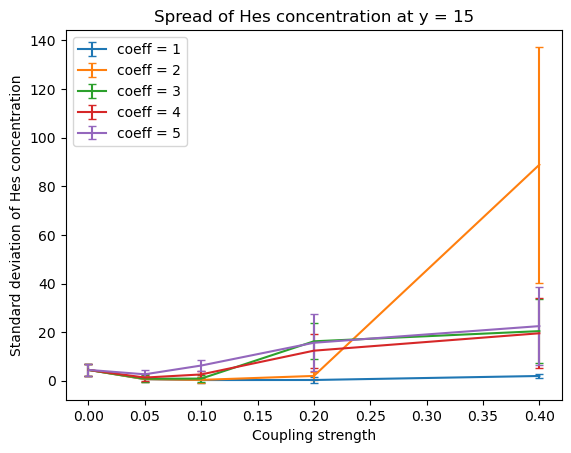

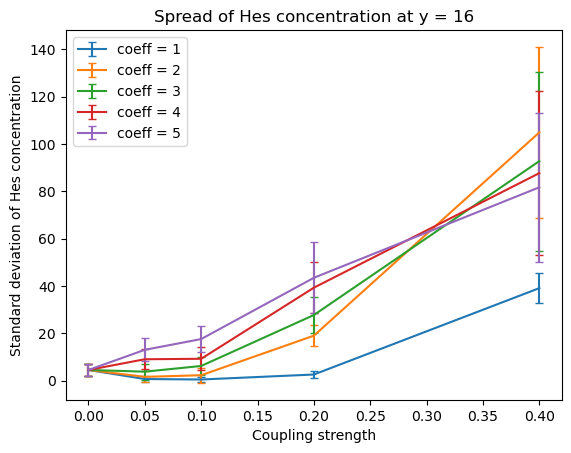

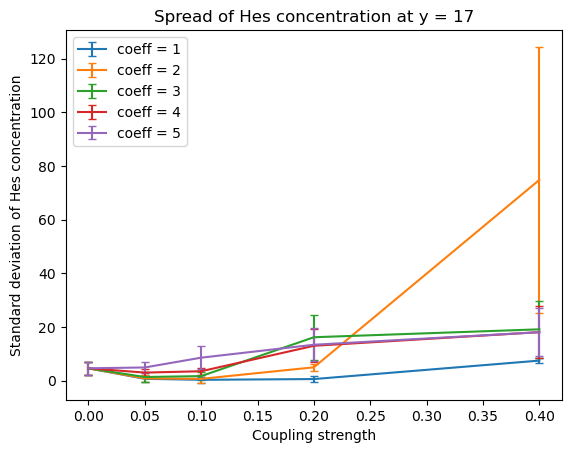

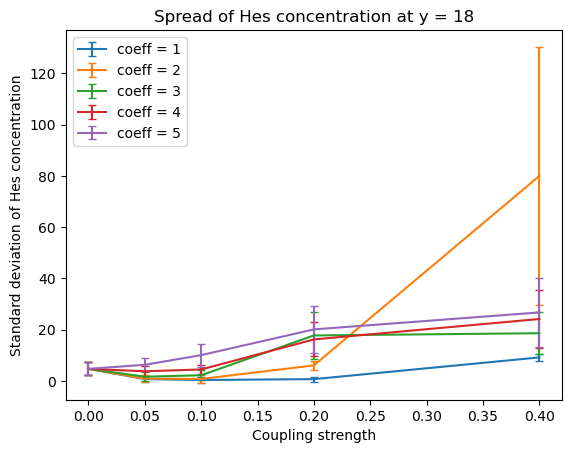

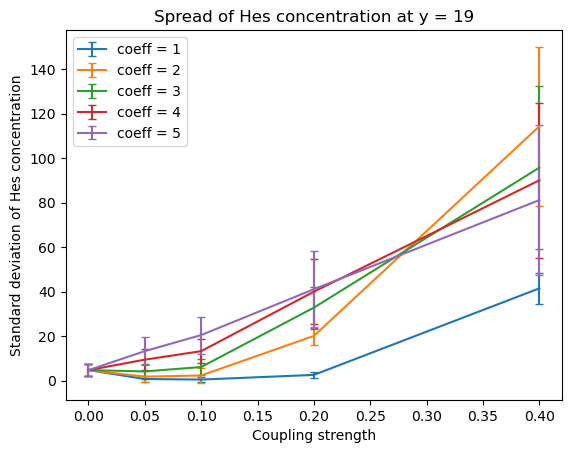

In [18]:
for p in range(lattice.P):    
    P_of_interest = p

    standard_deviation = np.zeros([len(coefficients), len(coupling_strengths), num_tsteps])
    mean = np.zeros([len(coefficients), len(coupling_strengths), num_tsteps])


    for i in range(len(coefficients)):
        for j in range(len(coupling_strengths)):
            values = results[i, j, :, :, :]
            for k in range(num_tsteps):
                standard_deviation[i,j,k] = np.std(values[k, P_of_interest, :])
                mean[i,j] = np.mean(values[k, P_of_interest, :])

    plt.figure()
    for i in range(len(coefficients)):
        plt.errorbar(coupling_strengths, np.mean(standard_deviation[i,:,500:], axis = 1), np.std(standard_deviation[i,:,500:], axis = 1), label = f'coeff = {coefficients[i]}', capsize = 3)

    plt.legend()
    plt.xlabel('Coupling strength')
    plt.ylabel('Standard deviation of Hes concentration')
    plt.title(f'Spread of Hes concentration at y = {P_of_interest}')


## Results 2D

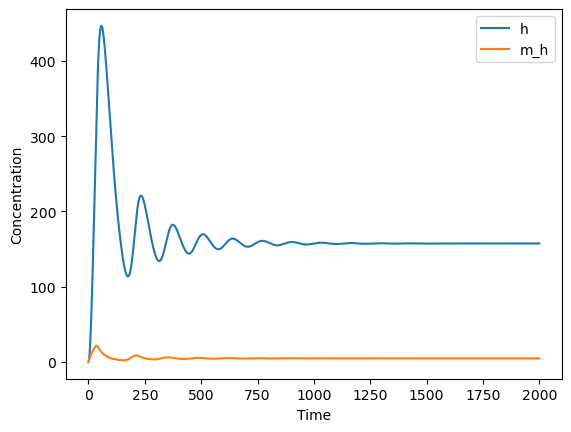

C:\Users\kbmcd\AppData\Local\Temp\ipykernel_20300\1541200298.py:29: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


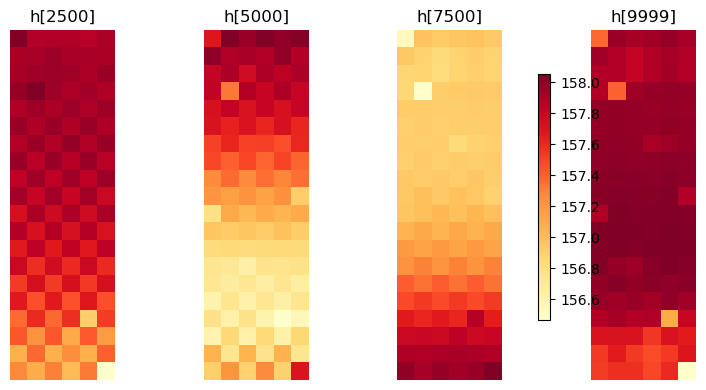

In [35]:
plt.figure()
plt.plot(np.arange(num_tsteps)*dt, h[:,0,0], label = 'h')
plt.plot(np.arange(num_tsteps)*dt, m_h[:,0,0], label = 'm_h')
#plt.plot(d[:,10,0], label = 'd')
# plt.plot(m_d[:,10,0], label = 'm_d')

plt.xlabel('Time')
plt.ylabel('Concentration')
plt.legend()
plt.show()

# Assuming h is already defined and has shape (n, x, y)
n = h.shape[0]

# Define the indices for 1/4, 1/2, 3/4, and last
indices = [n // 4, n // 2, (3 * n) // 4, n - 1]
titles = [f'h[{i}]' for i in indices]

# Create the 4 subplots in a row
fig, axs = plt.subplots(1, 4, figsize=(8, 4))

for ax, idx, title in zip(axs, indices, titles):
    im = ax.imshow(h[idx, :, :], cmap='YlOrRd')
    ax.set_title(title)
    ax.axis('off')

# Add a colorbar to the right of all subplots
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.8)
plt.tight_layout()
plt.show()

# plt.figure()
# plt.imshow(h[0,:,:], cmap='YlOrRd')
# plt.colorbar()
# plt.show()
# plt.figure()
# plt.imshow(h[-1,:,:], cmap='YlOrRd')
# plt.colorbar()


### Animation of 2D

Animation size has reached 20981492 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


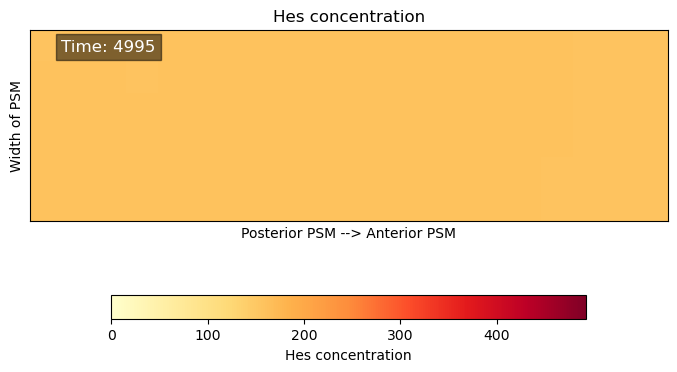

In [34]:
animate_2D(h[::10,:,:], interval=5, plot_save=False, filename='2D_unstable_travelling_wave.gif', title = 'Hes concentration')

## Phase space diagrams

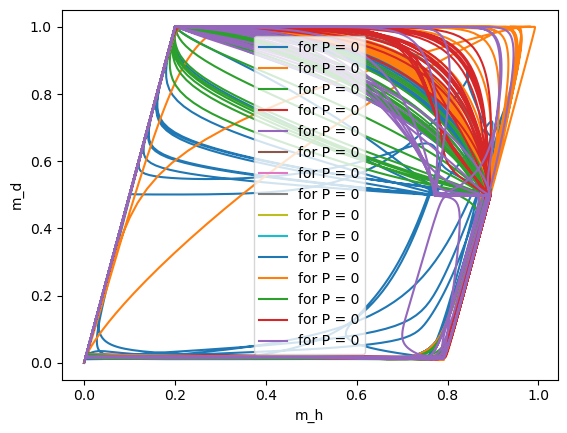

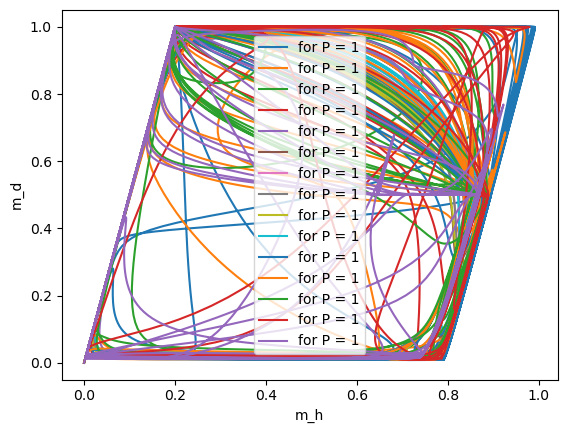

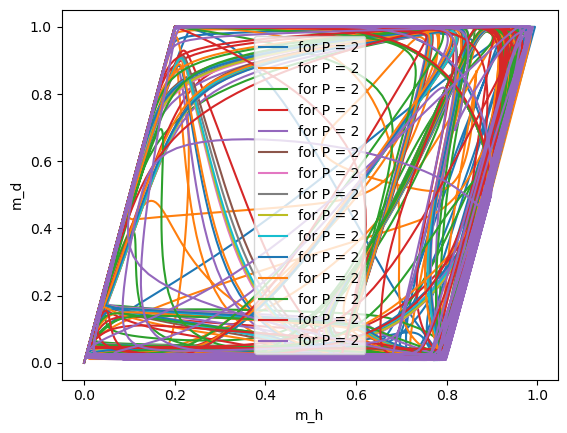

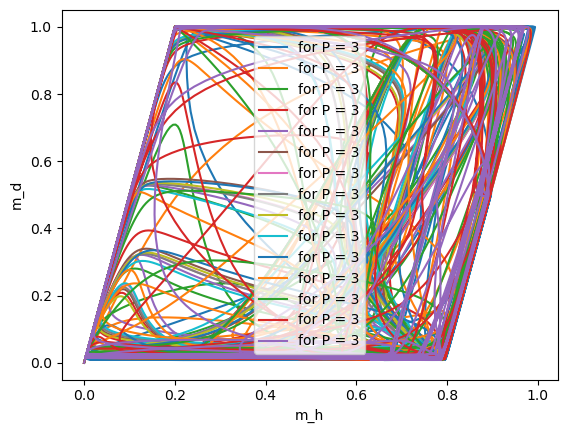

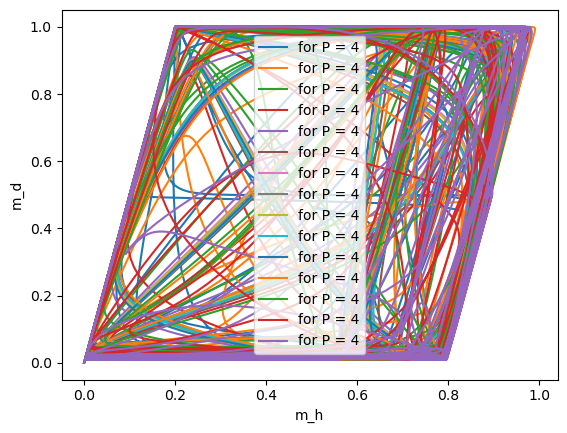

...

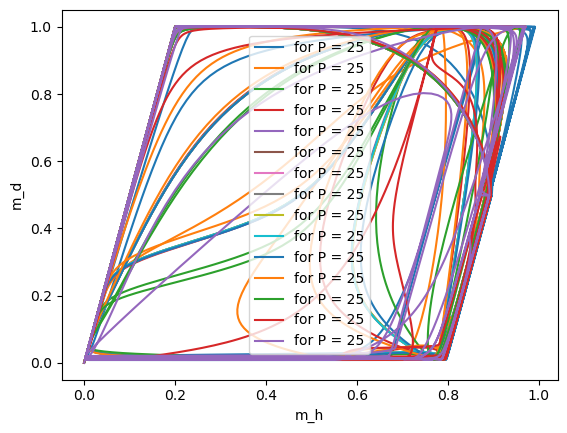

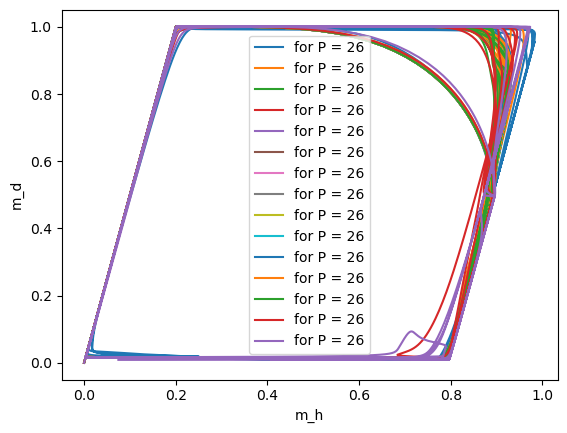

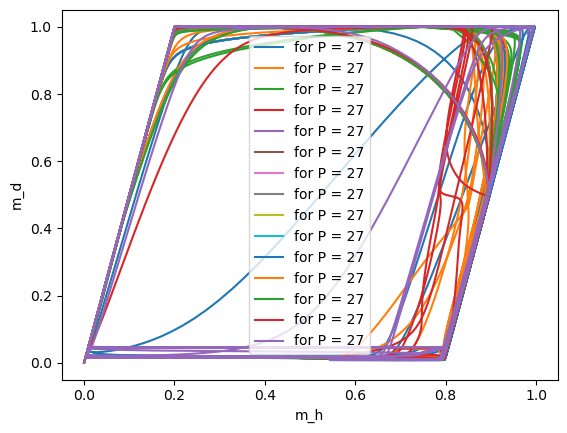

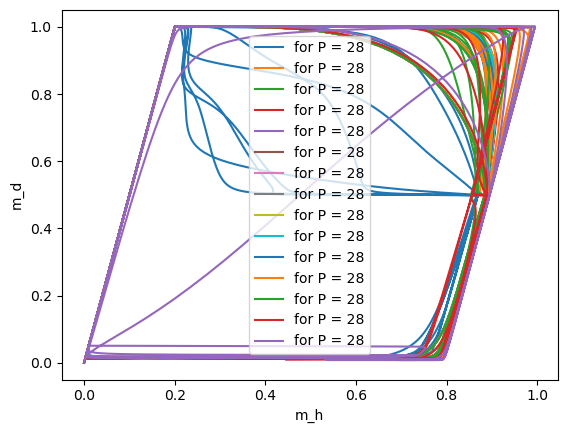

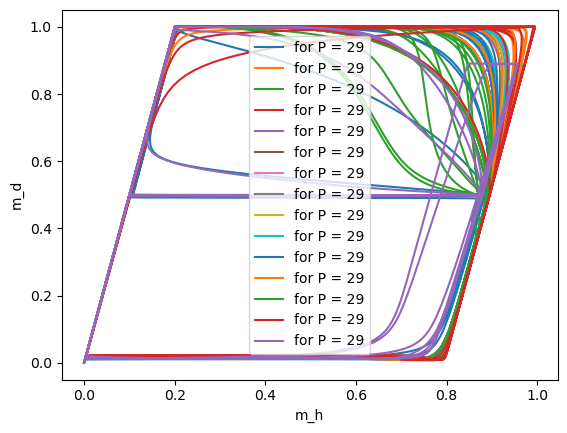

In [39]:
for i in range(lattice.P):
    plt.figure()
    for j in range(lattice.Q):
        q_test = j
        plt.plot(m_h[:,i,q_test], m_d[:,i,q_test],  label = 'for P = ' + str(i))
    plt.xlabel('m_h')
    plt.ylabel('m_d')
    plt.legend()
    plt.show()

## Get observables from the system

In [1]:
import matplotlib.cm as cm
import matplotlib.colors as mcolors

def get_roughness(data):
    """ Calculates the arithmetic roughness of the data for a specific slice along the width of the PSM."""

    mean_data = np.mean(data)
    deviations = data - mean_data
    roughness = np.mean(np.abs(deviations))

    return roughness

def generate_color_spectrum(P, cmap_name='viridis'):
    """
    Generate a spectrum of P colors from a given colormap.
    
    Parameters:
        P (int): Number of points/colors needed.
        cmap_name (str): Name of the matplotlib colormap (default: 'viridis').

    Returns:
        List of RGB color values.
    """
    cmap = plt.get_cmap(cmap_name)
    colors = [cmap(i / (P - 1)) for i in range(P)]
    return colors

# Example usage
colors = generate_color_spectrum(lattice.P, cmap_name='plasma')

def windowed_average(data, window_size):
    """
    Calculate the windowed average of data using a moving window of specified size.
    
    Parameters:
        data (ndarray): 2D array of data to be averaged.
        window_size (int): Size of the moving window.
    
    Returns:
        Averaged data array.
    """
    data = data.reshape(-1, data.shape[-1])
    
    data_avg = np.zeros_like(data)
    for i in range(data.shape[0]):
        data_avg[i] = np.convolve(data[i], np.ones(window_size), mode='same') / window_size
    return data_avg

roughness_parameters = np.zeros((h.shape[0], h.shape[1]))

for i in range(h.shape[0]):
    for j in range(h.shape[1]):
        roughness_parameters[i,j] = get_roughness(h[i,j,:])

# for j in range(h.shape[1]):    
#     roughness_parameters[:,j] = windowed_average(roughness_parameters[:,j], 500)   

print(roughness_parameters)




NameError: name 'lattice' is not defined

## Results 1D

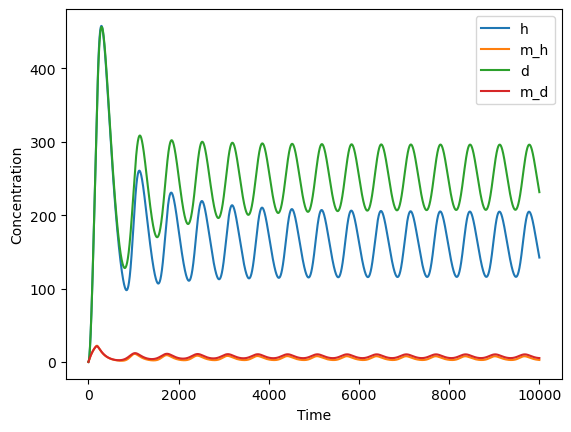

(10000, 20)


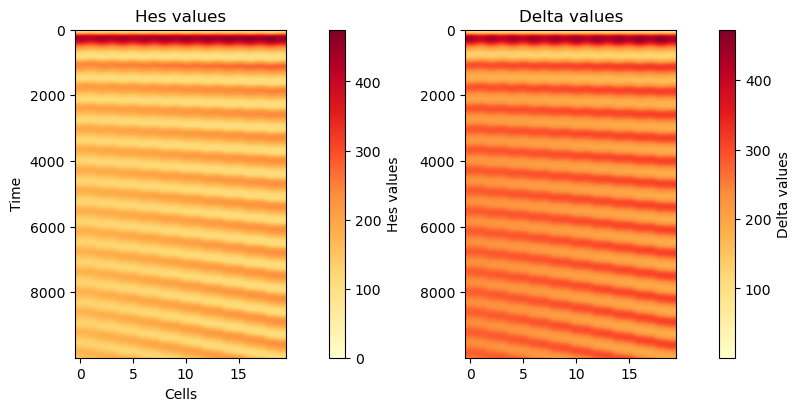

In [44]:
plt.figure()
plt.plot(h[:,10,0], label = 'h')
plt.plot(m_h[:,10,0], label = 'm_h')
plt.plot(d[:,10,0], label = 'd')
plt.plot(m_d[:,10,0], label = 'm_d')
plt.xlabel('Time')
plt.ylabel('Concentration')
plt.legend()
plt.show()

# Set up the figure and two axes for vertically stacked images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,4), constrained_layout=True)
h_flat = h.reshape(num_tsteps, lattice.P)
d_flat = d.reshape(num_tsteps, lattice.P)
print(h_flat.shape)

# Plot the first image
im1 = ax1.imshow(h_flat, aspect = 'auto',  cmap='YlOrRd', vmin = np.min(h), vmax = np.ceil(np.max(h)))
ax1.set_ylabel('Time')
ax1.set_xlabel('Cells')
ax1.set_title('Hes values')

# Add colorbar for the first image
cbar1 = fig.colorbar(im1, ax=ax1, orientation='vertical', fraction=0.1, pad=0.2)
cbar1.set_label('Hes values')

# Plot the second image
im2 = ax2.imshow(d_flat, aspect = 'auto',  cmap='YlOrRd', vmin = np.min(d), vmax = np.ceil(np.max(d)))
ax2.set_title('Delta values')

# Add colorbar for the second image
cbar2 = fig.colorbar(im2, ax=ax2, orientation='vertical', fraction=0.1, pad=0.2)
cbar2.set_label('Delta values')

In [61]:
i = 0
j = 0

In [62]:
coeff_1D = [1, 2, 3, 4, 5]

coupling_strengths_1D = np.linspace(0, 0.4, int(0.4/0.05) + 1)
results_1D = np.zeros([len(coeff_1D), len(coupling_strengths_1D), num_tsteps, lattice.P, lattice.Q, 4])

#values for system with no Delta
print('Calculating the no coupling system')
h0, m_h0, d0, m_d0 = test_Delta_coup(coeff_1D[0], coupling_strengths_1D[i], lattice, num_tsteps, dt)

for i in range(len(coeff_1D)):
    for j in range(len(coupling_strengths_1D)):
        if j == 0:
            h, m_h, d, m_d = h0, m_h0, d0, m_d0
        else:
            h, m_h, d, m_d = test_Delta_coup(coeff_1D[i], coupling_strengths_1D[j], lattice, num_tsteps, dt)
        
        # Save the results in the 5D array
        results_1D[i,j,:,:,:,0] = h
        results_1D[i,j,:,:,:,1] = m_h
        results_1D[i,j,:,:,:,2] = d
        results_1D[i,j,:,:,:,3] = m_d


# save the results to a file\

data_dict = {
    'results_1D': results_1D,
    'coeff_1D': coeff_1D,
    'coupling_strengths_1D': coupling_strengths_1D, 
    'num_tsteps': num_tsteps,	
    'dt': dt,
    'lattice': lattice,
    'params': params,
}

with open("results_delta_15_04_1D.pkl", "wb") as file:
    pickle.dump(data_dict, file)

Calculating the no coupling system
Coefficient: 1
Coupling strength: 0.0


  1%|          | 105/9999 [00:00<00:19, 518.95it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:20<00:00, 490.78it/s]


Coefficient: 1
Coupling strength: 0.05


  0%|          | 42/9999 [00:00<00:24, 408.68it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:20<00:00, 477.85it/s]


Coefficient: 1
Coupling strength: 0.1


  0%|          | 47/9999 [00:00<00:21, 461.87it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 510.50it/s]


Coefficient: 1
Coupling strength: 0.15000000000000002


  1%|          | 109/9999 [00:00<00:18, 540.07it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 508.64it/s]


Coefficient: 1
Coupling strength: 0.2


  0%|          | 31/9999 [00:00<00:32, 307.82it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:18<00:00, 533.27it/s]


Coefficient: 1
Coupling strength: 0.25


  1%|          | 74/9999 [00:00<00:26, 376.29it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 513.48it/s]


Coefficient: 1
Coupling strength: 0.30000000000000004


  1%|          | 70/9999 [00:00<00:28, 352.41it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 525.33it/s]


Coefficient: 1
Coupling strength: 0.35000000000000003


  1%|          | 76/9999 [00:00<00:25, 382.50it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 510.10it/s]


Coefficient: 1
Coupling strength: 0.4


  0%|          | 46/9999 [00:00<00:21, 456.46it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:18<00:00, 534.05it/s]


Coefficient: 2
Coupling strength: 0.05


  1%|          | 89/9999 [00:00<00:22, 444.24it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 507.93it/s]


Coefficient: 2
Coupling strength: 0.1


  1%|          | 50/9999 [00:00<00:20, 496.39it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:21<00:00, 470.73it/s]


Coefficient: 2
Coupling strength: 0.15000000000000002


  1%|          | 93/9999 [00:00<00:21, 471.06it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:18<00:00, 532.07it/s]


Coefficient: 2
Coupling strength: 0.2


  0%|          | 38/9999 [00:00<00:26, 377.27it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 515.33it/s]


Coefficient: 2
Coupling strength: 0.25


  0%|          | 46/9999 [00:00<00:22, 452.07it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 518.96it/s]


Coefficient: 2
Coupling strength: 0.30000000000000004


  0%|          | 44/9999 [00:00<00:23, 432.39it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 513.19it/s]


Coefficient: 2
Coupling strength: 0.35000000000000003


  0%|          | 26/9999 [00:00<00:39, 250.67it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:20<00:00, 492.40it/s]


Coefficient: 2
Coupling strength: 0.4


  0%|          | 39/9999 [00:00<00:26, 376.00it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 503.27it/s]


Coefficient: 3
Coupling strength: 0.05


  1%|          | 80/9999 [00:00<00:24, 397.10it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:21<00:00, 473.09it/s]


Coefficient: 3
Coupling strength: 0.1


  1%|          | 53/9999 [00:00<00:19, 520.78it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 503.28it/s]


Coefficient: 3
Coupling strength: 0.15000000000000002


  0%|          | 20/9999 [00:00<00:52, 189.18it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:15<00:00, 640.18it/s]


Coefficient: 3
Coupling strength: 0.2


  1%|▏         | 126/9999 [00:00<00:15, 629.87it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:14<00:00, 667.03it/s]


Coefficient: 3
Coupling strength: 0.25


  1%|          | 66/9999 [00:00<00:15, 655.20it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:14<00:00, 697.38it/s]


Coefficient: 3
Coupling strength: 0.30000000000000004


  1%|          | 63/9999 [00:00<00:15, 625.22it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:15<00:00, 657.49it/s]


Coefficient: 3
Coupling strength: 0.35000000000000003


  1%|          | 61/9999 [00:00<00:16, 605.59it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:16<00:00, 597.59it/s]


Coefficient: 3
Coupling strength: 0.4


  1%|          | 60/9999 [00:00<00:16, 595.66it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:23<00:00, 424.82it/s]


Coefficient: 4
Coupling strength: 0.05


  0%|          | 42/9999 [00:00<00:23, 416.96it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 509.75it/s]


Coefficient: 4
Coupling strength: 0.1


  0%|          | 47/9999 [00:00<00:21, 457.38it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:20<00:00, 476.25it/s]


Coefficient: 4
Coupling strength: 0.15000000000000002


  0%|          | 36/9999 [00:00<00:28, 353.88it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 502.06it/s]


Coefficient: 4
Coupling strength: 0.2


  1%|          | 72/9999 [00:00<00:26, 371.34it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:18<00:00, 546.43it/s]


Coefficient: 4
Coupling strength: 0.25


  0%|          | 49/9999 [00:00<00:20, 486.28it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 511.26it/s]


Coefficient: 4
Coupling strength: 0.30000000000000004


  1%|          | 108/9999 [00:00<00:18, 524.76it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 519.37it/s]


Coefficient: 4
Coupling strength: 0.35000000000000003


  0%|          | 44/9999 [00:00<00:22, 436.67it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:18<00:00, 533.34it/s]


Coefficient: 4
Coupling strength: 0.4


  0%|          | 45/9999 [00:00<00:22, 446.60it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:18<00:00, 532.04it/s]


Coefficient: 5
Coupling strength: 0.05


  0%|          | 41/9999 [00:00<00:24, 403.05it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:20<00:00, 480.61it/s]


Coefficient: 5
Coupling strength: 0.1


  0%|          | 32/9999 [00:00<00:31, 314.56it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 520.34it/s]


Coefficient: 5
Coupling strength: 0.15000000000000002


  1%|          | 84/9999 [00:00<00:23, 422.30it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:18<00:00, 540.38it/s]


Coefficient: 5
Coupling strength: 0.2


  0%|          | 43/9999 [00:00<00:23, 422.55it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:21<00:00, 471.96it/s]


Coefficient: 5
Coupling strength: 0.25


  0%|          | 38/9999 [00:00<00:26, 377.10it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:20<00:00, 481.30it/s]


Coefficient: 5
Coupling strength: 0.30000000000000004


  0%|          | 40/9999 [00:00<00:25, 385.56it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:20<00:00, 482.56it/s]


Coefficient: 5
Coupling strength: 0.35000000000000003


  0%|          | 32/9999 [00:00<00:31, 317.59it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:21<00:00, 456.05it/s]


Coefficient: 5
Coupling strength: 0.4


  0%|          | 32/9999 [00:00<00:31, 317.68it/s]

T_h_steps: [100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119]
T_coup_steps: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


100%|██████████| 9999/9999 [00:19<00:00, 515.33it/s]


C:\Users\kbmcd\AppData\Local\Temp\ipykernel_20300\3572850055.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6,3), constrained_layout=True)


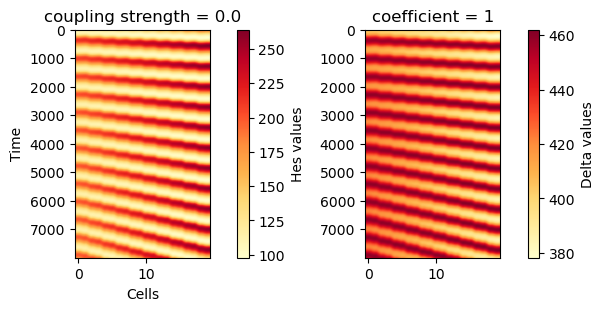

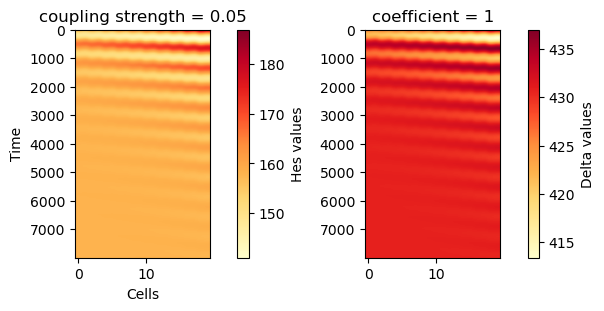

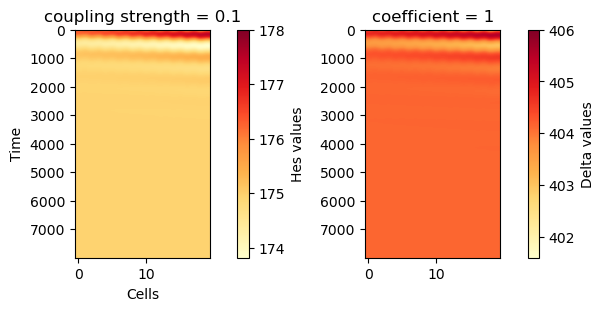

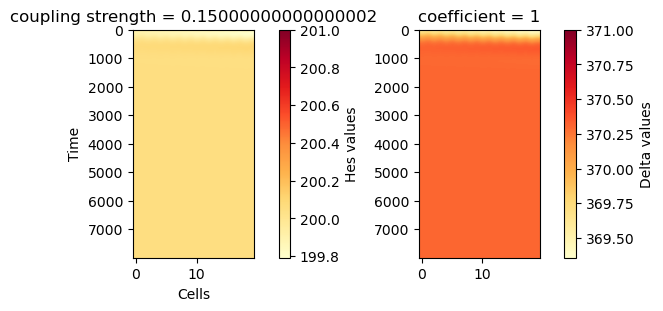

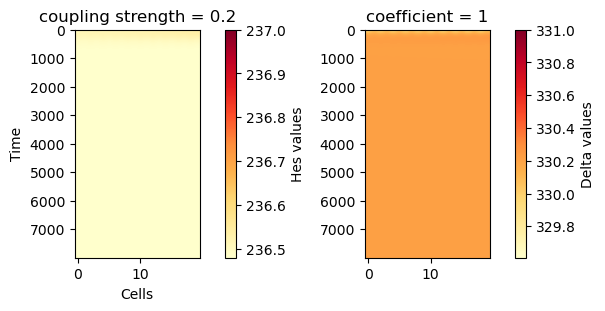

...

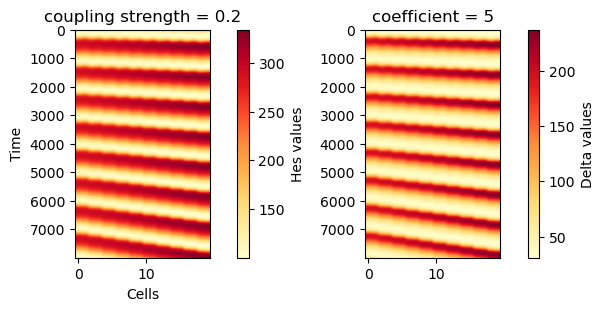

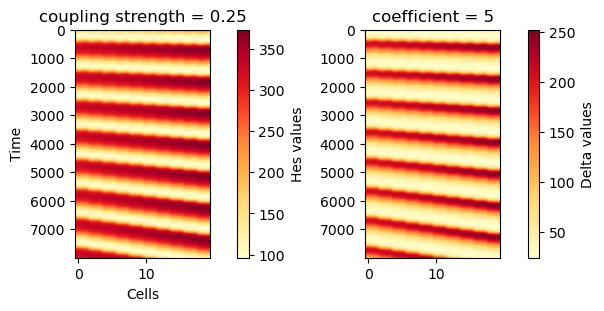

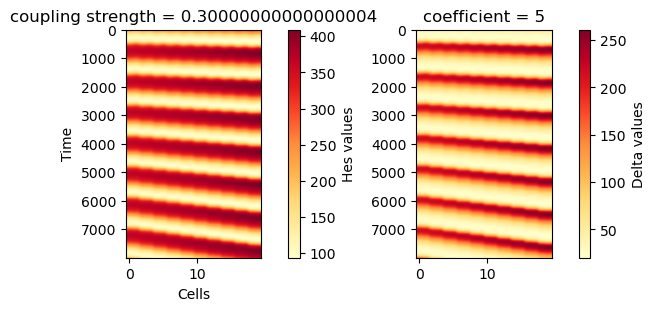

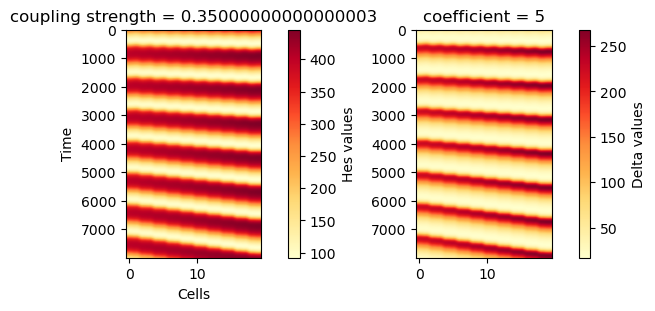

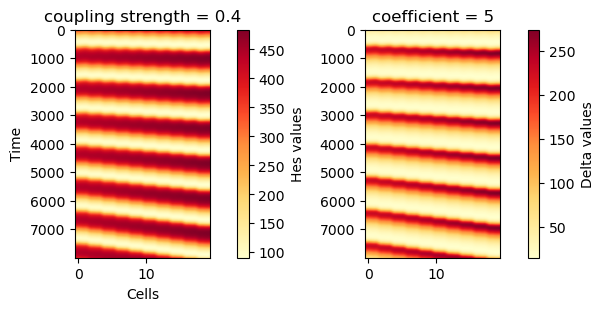

In [95]:
# Set up the figure and two axes for vertically stacked images
for i in range(len(coeff_1D)):
    for j in range(len(coupling_strengths_1D)):

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6,3), constrained_layout=True)
        h_flat = results_1D[i,j,2000:,:,0,0].reshape(num_tsteps-2000, lattice.P)
        d_flat = results_1D[i,j,2000:,:,0,2].reshape(num_tsteps-2000, lattice.P)

        # Plot the first image
        im1 = ax1.imshow(h_flat, aspect = 'auto',  cmap='YlOrRd', vmin = np.min(h_flat), vmax = np.ceil(np.max(h_flat)))
        ax1.set_ylabel('Time')
        ax1.set_xlabel('Cells')
        ax1.set_title('coupling strength = ' + str(coupling_strengths_1D[j]))

        # Add colorbar for the first image
        cbar1 = fig.colorbar(im1, ax=ax1, orientation='vertical', fraction=0.1, pad=0.2)
        cbar1.set_label('Hes values')

        # Plot the second image
        im2 = ax2.imshow(d_flat, aspect = 'auto',  cmap='YlOrRd', vmin = np.min(d_flat), vmax = np.ceil(np.max(d_flat)))
        ax2.set_title('coefficient = ' + str(coeff_1D[i]))

        # Add colorbar for the second image
        cbar2 = fig.colorbar(im2, ax=ax2, orientation='vertical', fraction=0.1, pad=0.2)
        cbar2.set_label('Delta values')

        fig.savefig('1D_h_d_coeff_' + str(coeff_1D[i]) + '_coup_' + str(coupling_strengths_1D[j]) + '.png', dpi=300, bbox_inches='tight')

In [142]:
#results_1D = np.zeros([len(coeff_1D), len(coupling_strengths_1D), num_tsteps, lattice.P, lattice.Q, 4])
from scipy.signal import find_peaks, correlate

def smoothen_signal(signal, window_size=5):
    """
    Smoothen a 1D signal using a moving average filter.

    Parameters:
    - signal: 1D numpy array of the signal values
    - window_size: Size of the moving window (default is 5)

    Returns:
    - smoothed_signal: Smoothed signal (1D numpy array)
    """
    if window_size < 1:
        raise ValueError("Window size must be at least 1.")
    
    # Create the moving average filter
    kernel = np.ones(window_size) / window_size
    smoothed_signal = np.convolve(signal, kernel, mode='same')

    return smoothed_signal

def estimate_period_from_peaks(signal, time=None, height=None, distance=None, prominence=None):
    """
    Estimate the period of an oscillating signal using peak detection.

    Parameters:
    - signal: 1D numpy array of the signal values
    - time: Optional 1D array of time values (same length as signal). If None, assume uniform time steps.
    - height, distance, prominence: Optional arguments passed to find_peaks for filtering.

    Returns:
    - period: Estimated average period (float)
    - peak_times: Time values of the detected peaks
    """
    # Find peaks
    peaks, _ = find_peaks(signal, height=height, distance=distance, prominence=prominence)
    if time is None:
        # Assume uniform spacing
        time = np.arange(len(signal))

    peak_times = time[peaks]

    if len(peak_times) < 4:
        period = -1000  # Not enough peaks to estimate period

    # Calculate differences between consecutive peaks
    peak_diffs = np.diff(peak_times)
    period = np.mean(peak_diffs)

    return period, peak_times

def estimate_period_fft(signal, time=None, detrend=False):
    """
    Estimate the dominant period of a signal using Fourier Transform.

    Parameters:
    - signal: 1D array of signal values
    - time: 1D array of time values (if None, assume uniform time steps)
    - detrend: Remove the mean before FFT to reduce DC offset

    Returns:
    - period: Estimated dominant period
    - freqs: Frequencies used
    - power: Power spectrum
    """
    if time is None:
        dt = 1.0  # assume uniform spacing of 1
        time = np.arange(len(signal))
    else:
        dt = np.mean(np.diff(time))  # average time step

    if detrend:
        signal = signal - np.mean(signal)  # remove DC component

    # Perform FFT
    fft_vals = np.fft.fft(signal)
    fft_freqs = np.fft.fftfreq(len(signal), d=dt)

    # Use only positive frequencies
    pos_mask = fft_freqs > 0
    freqs = fft_freqs[pos_mask]
    power = np.abs(fft_vals[pos_mask])**2

    # Find the peak frequency
    peak_idx = np.argmax(power)
    dominant_freq = freqs[peak_idx]
    period = 1 / dominant_freq

    return period, freqs, power

def estimate_period_autocorr(signal, time=None, detrend=False, height = None, min_period=1):
    """
    Estimate the dominant period of a signal using autocorrelation.

    Parameters:
    - signal: 1D array of the signal values
    - time: 1D array of time points (optional, required for real period values)
    - detrend: Whether to subtract the mean (removes DC offset)
    - min_period: Minimum time (or index) to consider between peaks

    Returns:
    - estimated_period: Dominant period (in time units if time is provided)
    - lags: Lag values
    - autocorr: Autocorrelation values
    """
    n = len(signal)

    if detrend:
        signal = signal - np.mean(signal)

    # Full autocorrelation, symmetric around center
    autocorr_full = correlate(signal, signal, mode='full')
    autocorr = autocorr_full[n-1:]  # second half only
    autocorr /= autocorr[0]  # normalize

    lags = np.arange(len(autocorr))

    # Find peaks in autocorrelation
    peaks, _ = find_peaks(autocorr, distance=min_period, height=height)

    if len(peaks) < 1:
        return None, lags, autocorr  # No peaks found

    dominant_lag = peaks[0]

    if time is not None:
        dt = np.mean(np.diff(time))
        estimated_period = dominant_lag * dt
    else:
        estimated_period = dominant_lag  # in sample units

    return estimated_period, lags, autocorr

# find periods for the 1D system, per cell 
periods_peaks = np.zeros([len(coeff_1D), len(coupling_strengths_1D), lattice.P])
periods_fft = np.zeros([len(coeff_1D), len(coupling_strengths_1D), lattice.P])
periods_autocorr = np.zeros([len(coeff_1D), len(coupling_strengths_1D), lattice.P])

for i in range(len(coeff_1D)):
    for j in range(len(coupling_strengths_1D)):
        for p in range(lattice.P):
            # analyse second half of signal 
            time_analysis = int(num_tsteps/2)
            signal = results_1D[i,j,time_analysis:,p,0,0].flatten()
            signal_max = np.max(signal)
            signal_min = np.min(signal)
            amplitude_threshold = 20

            # find the period of the oscillation for each cell
            periods_peaks[i,j,p]= estimate_period_from_peaks(signal, time = np.arange(int(num_tsteps/2))*dt, height=amplitude_threshold)[0]
            periods_fft[i,j,p] = estimate_period_fft(signal, time = np.arange(int(num_tsteps/2))*dt)[0]
            periods_autocorr[i,j,p] = estimate_period_autocorr(signal, time = np.arange(int(num_tsteps/2))*dt, height=None)[0]


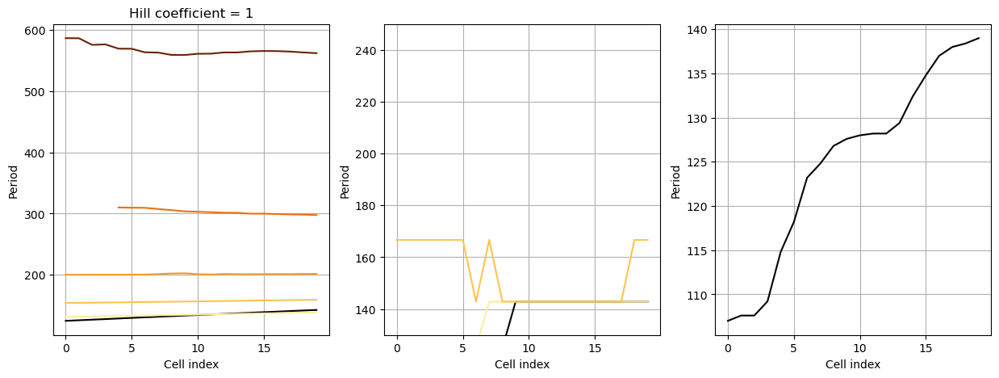

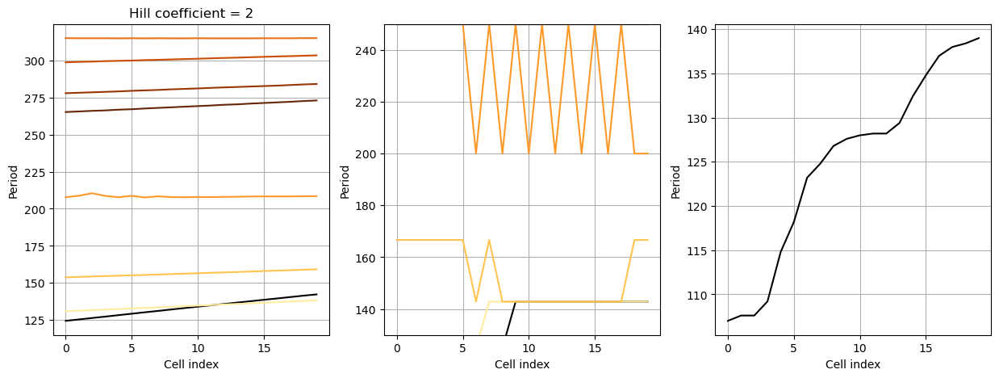

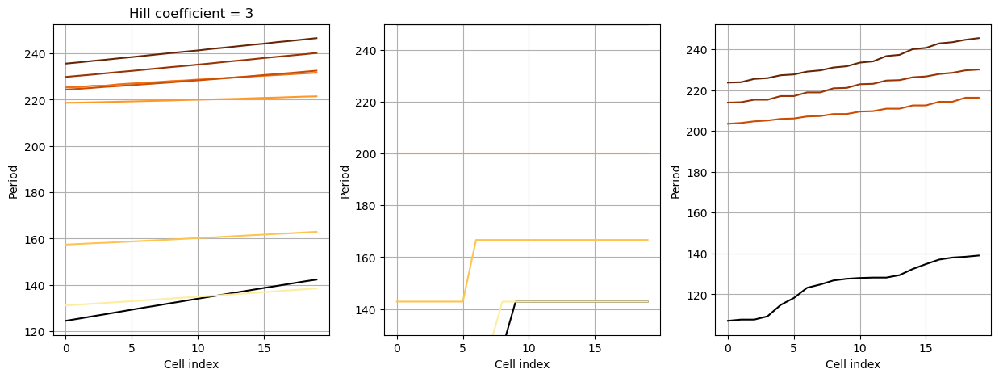

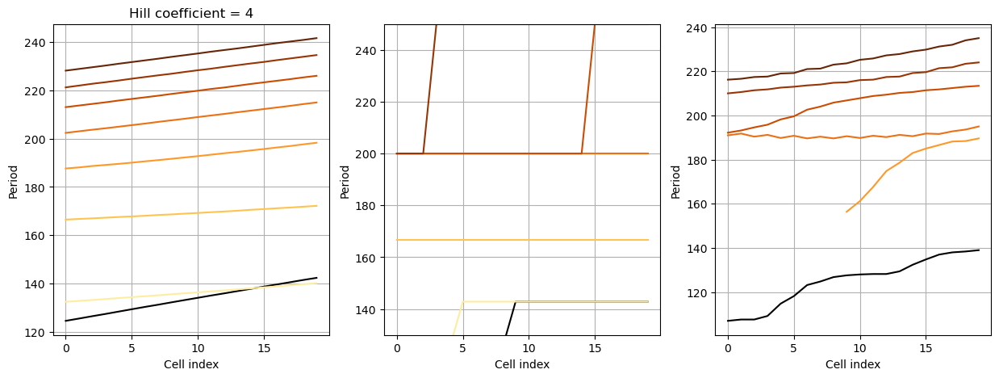

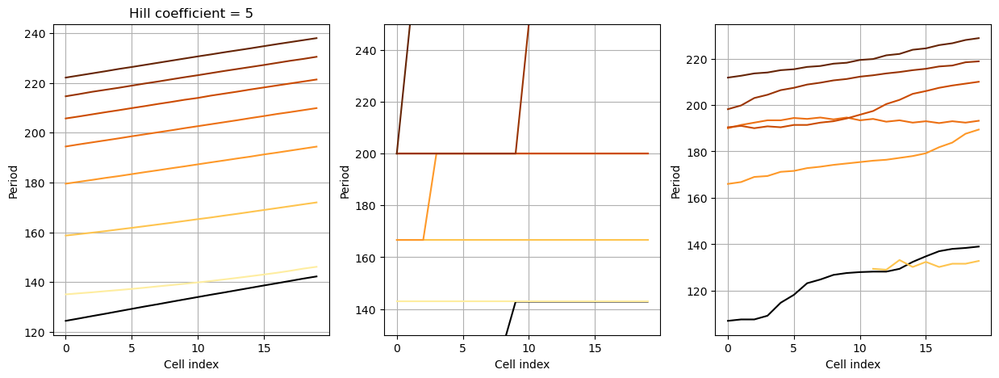

In [143]:
colors_coeffs = ['#ffffb2', '#fecc5c', '#fd8d3c', '#f03b20', '#bd0026']
colors_strengths = ['#feeda0', '#fec44f', '#fe9929', '#ec7014', '#cc4c02', '#993404', '#662506']


for i in range(len(coeff_1D)):
    plt.figure(figsize=(15,5))
    plt.subplot(1, 3, 1)
    plt.plot(np.arange(lattice.P), periods_peaks[0,0,:], label = 'no coupling periods', color = 'black')
    plt.xlabel('Cell index')
    plt.ylabel('Period')
    plt.grid()
    
    for j in range(1, len(coupling_strengths_1D)-1):
        plt.plot(np.arange(lattice.P), periods_peaks[i,j,:], color = colors_strengths[j-1], label = f'coeff = {coeff_1D[i]}, coup_strength = {coupling_strengths_1D[j]}')
    plt.title(f'Hill coefficient = {coeff_1D[i]}')


    plt.subplot(1,3,2)
    plt.plot(np.arange(lattice.P), periods_fft[0,0,:], label = 'no coupling periods', color = 'black')
    for j in range(1, len(coupling_strengths_1D)-1):
        plt.plot(np.arange(lattice.P), periods_fft[i,j,:], color = colors_strengths[j-1], label = f'coeff = {coeff_1D[i]}, coup_strength = {coupling_strengths_1D[j]}')
    plt.ylim(130,250)
    plt.xlabel('Cell index')
    plt.ylabel('Period')
    plt.grid()

    plt.subplot(1,3,3)
    plt.plot(np.arange(lattice.P), periods_autocorr[0,0,:], label = 'no coupling periods', color = 'black')
    for j in range(1, len(coupling_strengths_1D)-1):
        plt.plot(np.arange(lattice.P), periods_autocorr[i,j,:], color = colors_strengths[j-1], label = f'coeff = {coeff_1D[i]}, coup_strength = {coupling_strengths_1D[j]}')

    plt.xlabel('Cell index')
    plt.ylabel('Period')
    plt.grid()



## Make plots for presentations

Text(0, 0.5, 'Time delay (mins)')

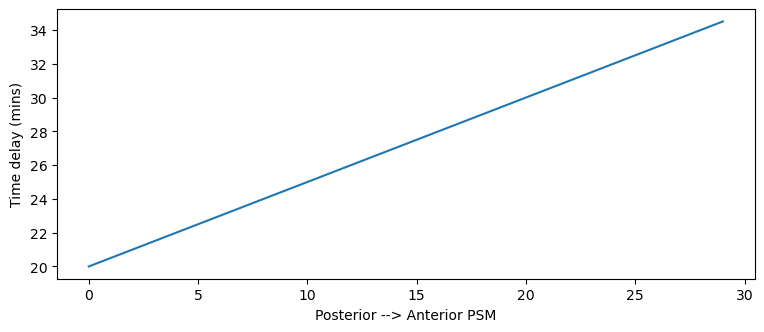

In [9]:
plt.figure(figsize=(9,3.5))
plt.plot(params.tau_total)
plt.xlabel('Posterior --> Anterior PSM')
plt.ylabel('Time delay (mins)')

<function matplotlib.pyplot.tight_layout(*, pad: 'float' = 1.08, h_pad: 'float | None' = None, w_pad: 'float | None' = None, rect: 'tuple[float, float, float, float] | None' = None) -> 'None'>

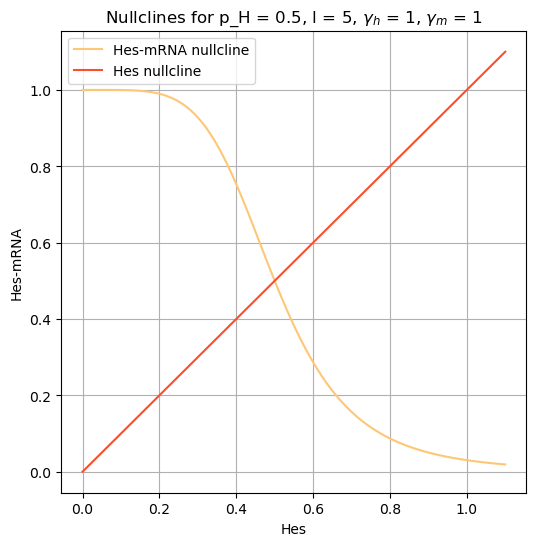

In [28]:
p_h = 0.5
l = 5
gamma_h = 1
gamma_m = 1

def nullclines_Hes(m_h, h, p_h, l, gamma_h, gamma_m):
    """Calculate the nullclines for Hes."""
    # Hes protein nullcline
    h_null = gamma_h**(-1)*m_h
    
    # Hes mRNA nullcline
    m_h_null = gamma_m**(-1) * p_h**l / (p_h**l + h**l)

    return h_null, m_h_null

m_h_plot = np.linspace(0, 1, 100)*1.1
h_plot = np.linspace(0, 1, 100)*1.1
m_h_null_plot, h_null_plot = nullclines_Hes(m_h_plot, h_plot, p_h, l, gamma_h, gamma_m)

hescolor1 = '#fdc776'  # light
hescolor2 = '#fc4e2a'  # dark
plt.figure(figsize=(6, 6)) 
plt.plot(m_h_plot, h_null_plot, label='Hes-mRNA nullcline', color = hescolor1)
plt.plot(h_plot, m_h_null_plot, label='Hes nullcline', color = hescolor2)
plt.xlabel('Hes')
plt.ylabel('Hes-mRNA')
plt.title('Nullclines for p_H = ' + str(p_h) + ', l = ' + str(l) + ', $\gamma_h$ = ' + str(gamma_h) + ', $\gamma_m$ = ' + str(gamma_m))
plt.grid()
plt.legend()
plt.tight_layout


In [15]:
print(1000/(33*4.5))

6.734006734006734
